In [2]:
import xarray as xr
import matplotlib.pyplot as plt
import hvplot.xarray
import iris_grib
import matplotlib.pyplot as plt
import numpy as np
import warnings
warnings.filterwarnings('ignore')

## Open a grib file using Xarray and convert longitude from 0 <= lon < 360 to -180 <= lon < 180

In [3]:
%time
gfs_360 = xr.open_dataset('../data/weather/gfs.0p25.2016072200.f000_WIND_10m.grib2', engine='cfgrib', backend_kwargs={'filter_by_keys': {'stepType': 'instant','typeOfLevel': 'heightAboveGround'}})


CPU times: user 2 µs, sys: 1e+03 ns, total: 3 µs
Wall time: 6.2 µs


In [4]:
%time

# required for hrrr, gfs, 
def convert_360_to_180_long(d):
    return d.assign_coords({"longitude":(((d.longitude + 180.0) % 360.0) - 180.0)})


gfs_180 = convert_360_to_180_long(gfs_360).sortby('longitude')
gfs_180

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 5.25 µs


<xarray.Dataset>
Dimensions:            (latitude: 721, longitude: 1440)
Coordinates:
    time               datetime64[ns] ...
    step               timedelta64[ns] ...
    heightAboveGround  float64 ...
  * latitude           (latitude) float64 90.0 89.75 89.5 ... -89.5 -89.75 -90.0
  * longitude          (longitude) float64 -180.0 -179.8 -179.5 ... 179.5 179.8
    valid_time         datetime64[ns] ...
Data variables:
    u10                (latitude, longitude) float32 ...
    v10                (latitude, longitude) float32 ...
Attributes:
    GRIB_edition:            2
    GRIB_centre:             kwbc
    GRIB_centreDescription:  US National Weather Service - NCEP 
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             US National Weather Service - NCEP 
    history:                 2021-12-14T13:04 GRIB to CDM+CF via cfgrib-0.9.9...

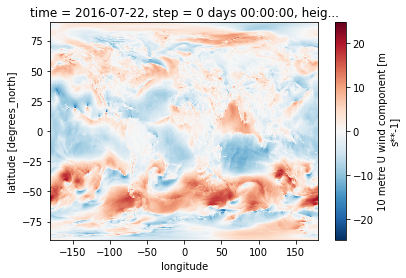

In [5]:
# Plot just the u component of wind speed.
t = gfs_180['u10'].sortby('longitude')
x = t.plot()
x


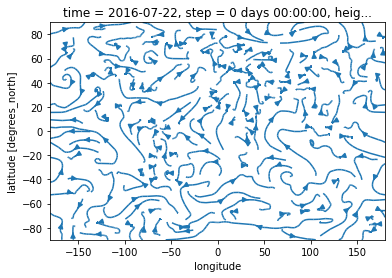

In [6]:
# Plot streamplots of the wind speed.
gfs_180.sortby('latitude').plot.streamplot(x="longitude", y="latitude", u="u10", v="v10")

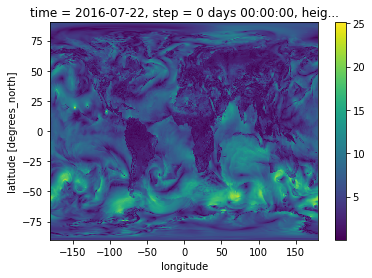

In [7]:
# Plot the windspeed.
import xarray.ufuncs as xu
windspeed = xu.sqrt(gfs_180.u10**2+gfs_180.v10**2).sortby('longitude')
windspeed.plot()

In [8]:
# An alternative to plotting wind speed that allows hovering.
viz = windspeed[:,:].hvplot(x='longitude', y='latitude', 
                    cmap='rainbow', rasterize=True, coastline=True,
                    title='GFS Windspeed Meters Per Second', hover=True)
viz

OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


:DynamicMap   []
   :Overlay
      .Image.I     :Image   [longitude,latitude]   (value)
      .Coastline.I :Feature   [Longitude,Latitude]

In [9]:
# Convert windspeed in meters per second to knots.
windspeed_kts = windspeed * 1.94384
# Plot windspeed in kts
viz2 = windspeed_kts[:,:].hvplot(x='longitude', y='latitude', 
                    cmap='rainbow', rasterize=True, coastline=True,
                    title='GFS Windspeed Kts', hover=True)
viz2

:DynamicMap   []
   :Overlay
      .Image.I     :Image   [longitude,latitude]   (value)
      .Coastline.I :Feature   [Longitude,Latitude]

In [10]:
# Take a spatial slice of the grib.
min_lon = -50
min_lat = 25.05
max_lon = -49
max_lat = 26.55

mask_lon = (gfs_180.longitude >= min_lon) & (gfs_180.longitude <= max_lon)
mask_lat = (gfs_180.latitude >= min_lat) & (gfs_180.latitude <= max_lat)

my_slice = gfs_180.where(mask_lon & mask_lat, drop=True)

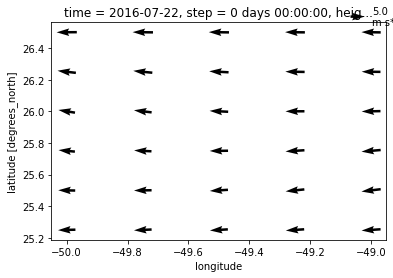

In [11]:

# Plot the directional vectors for the new slice.
my_slice.plot.quiver(x="longitude", y="latitude", u="u10", v="v10", scale=None)


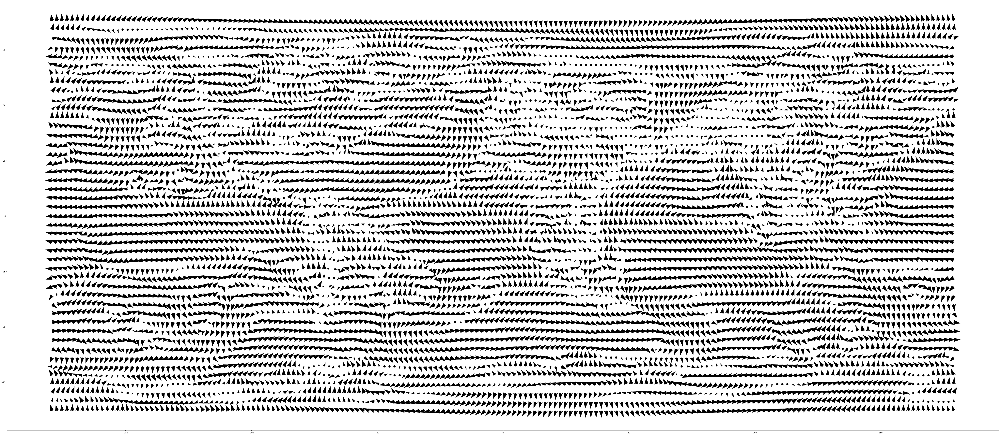

In [12]:
# Reduce the density of the data so we can plot directions for the whole world.
num_gfs_lats = 721
num_gfs_lons = 1440
num_desired_lats = 45
num_desired_lons = 180

norm = gfs_180/windspeed

# We need to "coarsen" the 0.25 degree gfs if we want to plot the whole world at once, otherwise all the arrows overlap and we just get a black rectangle.
p = norm.coarsen(longitude=int(num_gfs_lons/num_desired_lons), latitude=int(num_gfs_lats/num_desired_lats), boundary='trim').mean()
plt.figure(figsize=(90,40))

plt.quiver(p.coords['longitude'].values, p.coords['latitude'].values, p['u10'],  p['v10'])

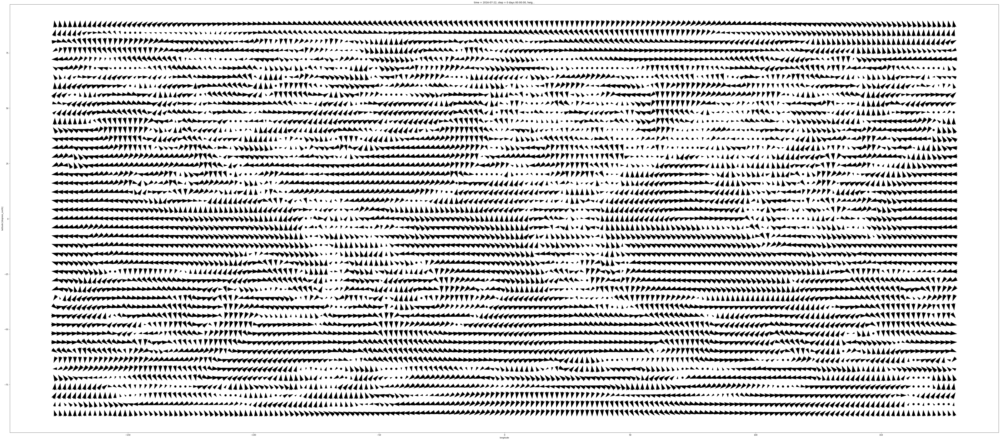

In [13]:
# This cell is just like above, but using a different method. There are usually multiple ways to do things.
num_gfs_lats = 721
num_gfs_lons = 1440
num_desired_lats = 45
num_desired_lons = 180

norm = gfs_180/windspeed
p = norm.coarsen(longitude=int(num_gfs_lons/num_desired_lons), latitude=int(num_gfs_lats/num_desired_lats), boundary='trim').mean()
plt.figure(figsize=(90,40))

p.plot.quiver(x="longitude", y="latitude", u="u10", v="v10")

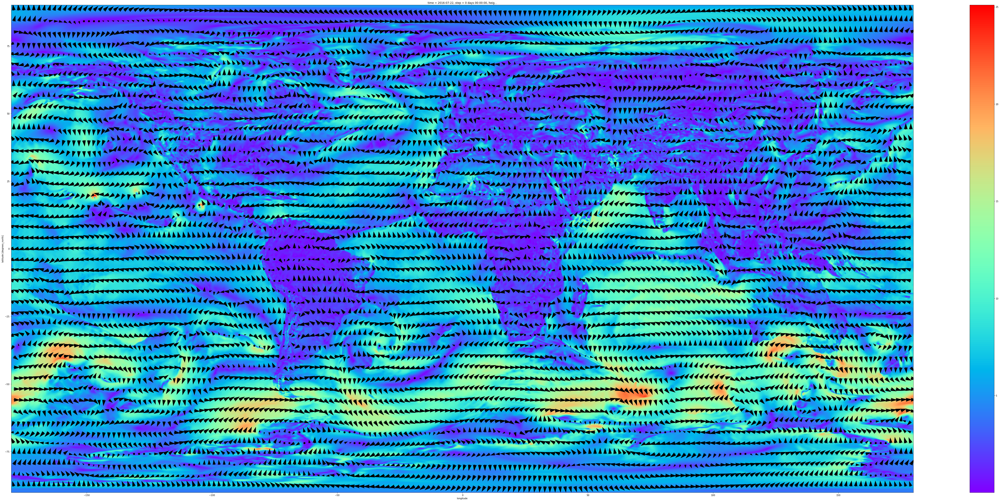

In [14]:
# The arrows are kind of useless without windspeed, wouldn't you agree?
# Let's plot direction and speed at the same time.
plt.figure(figsize=(90,40))
plt.title('GFS Windspeed and Direction')
plt.ylabel('latitude')
plt.xlabel('longitude')
windspeed.plot(cmap='rainbow')

x = p.coords['longitude'].values
y = p.coords['latitude'].values
plt.quiver(x, y, p.u10.values, p.v10.values)

In [14]:
# https://hvplot.holoviz.org/reference/xarray/vectorfield.html

Find the difference between two gribs:

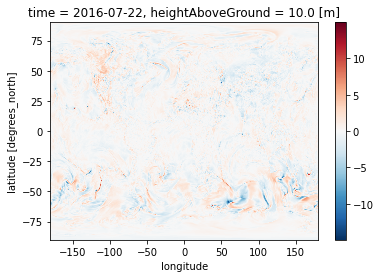

In [15]:
second_grib_360 =  xr.open_dataset('../data/weather/gfs.0p25.2016072200.f003_WIND_10m.grib2', engine='cfgrib', backend_kwargs={'filter_by_keys': {'stepType': 'instant','typeOfLevel': 'heightAboveGround'}})
second_grib_180 = convert_360_to_180_long(second_grib_360).sortby('longitude')
second_grib_windspeed = xu.sqrt(second_grib_180.u10**2+second_grib_180.v10**2).sortby('longitude')
difference = windspeed - second_grib_windspeed

difference.plot()